In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn import tree
import math

In [2]:
data = pd.read_csv('COVID19MEXICO2021.csv', low_memory=False);

### Querys
create table "COVID19".year2021PF as select "entidad_nac", "entidad_res", "sexo", "tipo_paciente", "edad", 
"diabetes", "epoc", "asma", "inmusupr", "hipertension", "otra_com", 
"cardiovascular", "obesidad", "renal_cronica", "tabaquismo", "fecha_def" 
from "COVID19".year2021 where "fecha_ingreso" < '2022-01-01' and "clasificacion_final" between 1 and 3;

update "COVID19".year2021PF set "fecha_def" = 1 where "fecha_def" != '9999-99-99';
update "COVID19".year2021PF set "fecha_def" = 0 where "fecha_def" = '9999-99-99';

alter table "COVID19".year2021PF rename "fecha_def" to "sobrevivio";

select * from "COVID19".year2021 LIMIT 10;

SELECT * FROM "COVID19".year2021pf where "sobrevivio" = '1';
SELECT * FROM "COVID19".year2021pf where "sobrevivio" != '1';
SELECT * FROM "COVID19".year2021pf;

In [3]:
data.columns

Index(['FECHA_ACTUALIZACION', 'ID_REGISTRO', 'ORIGEN', 'SECTOR', 'ENTIDAD_UM',
       'SEXO', 'ENTIDAD_NAC', 'ENTIDAD_RES', 'MUNICIPIO_RES', 'TIPO_PACIENTE',
       'FECHA_INGRESO', 'FECHA_SINTOMAS', 'FECHA_DEF', 'INTUBADO', 'NEUMONIA',
       'EDAD', 'NACIONALIDAD', 'EMBARAZO', 'HABLA_LENGUA_INDIG', 'INDIGENA',
       'DIABETES', 'EPOC', 'ASMA', 'INMUSUPR', 'HIPERTENSION', 'OTRA_COM',
       'CARDIOVASCULAR', 'OBESIDAD', 'RENAL_CRONICA', 'TABAQUISMO',
       'OTRO_CASO', 'TOMA_MUESTRA_LAB', 'RESULTADO_LAB',
       'TOMA_MUESTRA_ANTIGENO', 'RESULTADO_ANTIGENO', 'CLASIFICACION_FINAL',
       'MIGRANTE', 'PAIS_NACIONALIDAD', 'PAIS_ORIGEN', 'UCI'],
      dtype='object')

In [3]:
datacopy = data[(data['FECHA_INGRESO'] < '2022-01-01') & (data['CLASIFICACION_FINAL'].between(1, 3))][['ENTIDAD_NAC', 'ENTIDAD_RES', 'SEXO', 'TIPO_PACIENTE', 'EDAD', 'DIABETES', 'EPOC', 'ASMA', 'INMUSUPR', 'HIPERTENSION', 'OTRA_COM', 'CARDIOVASCULAR', 'OBESIDAD', 'RENAL_CRONICA', 'TABAQUISMO', 'FECHA_DEF']]

In [4]:
datacopy['FECHA_DEF'] = np.where(datacopy['FECHA_DEF'] == "9999-99-99", 0, 1)
datacopy.rename(columns={'FECHA_DEF': 'SOBREVIVIO'}, inplace=True)

In [13]:
datacopy.__len__

<bound method DataFrame.__len__ of          ENTIDAD_NAC  ENTIDAD_RES  SEXO  TIPO_PACIENTE  EDAD  DIABETES  EPOC   
6                 30           30     1              1    36         1     2  \
10                24           24     1              1    63         2     2   
16                 9            9     1              1    18         2     2   
57                25           26     1              1    44         2     2   
63                 9            9     1              1    61         1     2   
...              ...          ...   ...            ...   ...       ...   ...   
8830180           15           15     1              1    22         2     2   
8830182           15           15     1              1    21         2     2   
8830186           15           15     1              1    18         2     2   
8830205           15           15     2              1    31         2     2   
8830208           15           15     2              1    67         2     2   

    

In [6]:
features = ['SEXO', 'TIPO_PACIENTE', 'EDAD', 'DIABETES', 'EPOC', 'ASMA', 'INMUSUPR', 'HIPERTENSION', 'OTRA_COM', 'CARDIOVASCULAR', 'OBESIDAD', 'RENAL_CRONICA', 'TABAQUISMO']
X = datacopy[features]
Y = datacopy['SOBREVIVIO']

In [7]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

In [8]:
dtree = DecisionTreeClassifier()
dtree = dtree.fit(X_train, Y_train)

In [9]:
Y_pred = dtree.predict(X_test)

In [10]:
Y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [11]:
dtree.score(X_test,Y_test)

0.9552949661426683

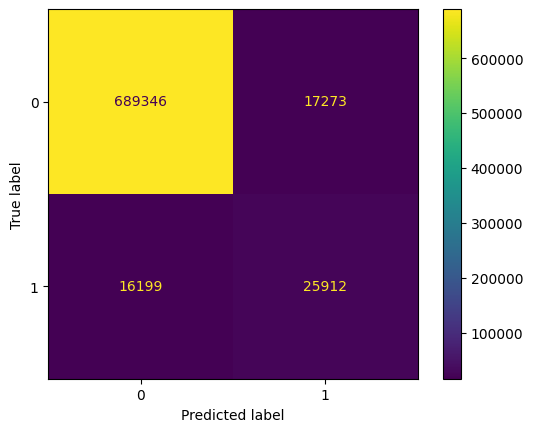

In [12]:
cm = confusion_matrix(Y_test, Y_pred)
ConfusionMatrixDisplay(cm).plot()

In [13]:
import graphviz 
dot_data = tree.export_graphviz(dtree, out_file=None, class_names= ['Sobrevivio', 'No Sobrevivio'], feature_names=features, filled=True, rounded=True, special_characters=True)
graph = graphviz.Source(dot_data)
#graph

In [14]:
graph

In [15]:
#dot_data = tree.export_graphviz(dtree, out_file=None, class_names= ['Sobrevivio', 'No Sobrevivio'], feature_names=features, filled=True, rounded=True, special_characters=True)
#graph = graphviz.Source(dot_data)

In [16]:
#graph